In [1]:
import pickle
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import datetime
from icecream import ic
from pathlib import Path
import time
import os
import tqdm

In [2]:
print("***** Put the interpreter in UTC, to make sure no TZ issues")
os.environ["TZ"] = "UTC"
time.tzset()

***** Put the interpreter in UTC, to make sure no TZ issues


# Start with importing the data from WHOI

## Use the code in https://github.com/jerabaul29/MachineOcean_WP1_WHOI

In [3]:
import sys
sys.path.append("../../../MachineOcean_WP1_WHOI/")

In [4]:
import mo_whoi_data

In [5]:
from mo_whoi_data.load_data import load_data_xarray
from mo_whoi_data.residual_learning_time_hist.predictors import predictors

***** Put the interpreter in UTC, to make sure no TZ issues


See Jean's code:

https://github.com/jerabaul29/MachineOcean_WP1_WHOI/blob/main/mo_whoi_data/residual_learning_time_hist/0_prepare_ml_data.ipynb

In [6]:
dict_all_Transfer_files = load_data_xarray.load_all_into_xarray(run_on_ppi=True)

all_filenames: [PosixPath('/lustre/storeB/project/IT/geout/machine-ocean/prepared_datasets/in_situ_data_WHOI/WHOI/Transfer_Endurance_7.mat'),
                PosixPath('/lustre/storeB/project/IT/geout/machine-ocean/prepared_datasets/in_situ_data_WHOI/WHOI/Transfer_SPURS1.mat'),
                PosixPath('/lustre/storeB/project/IT/geout/machine-ocean/prepared_datasets/in_situ_data_WHOI/WHOI/Transfer_Endurance_3.mat'),
                PosixPath('/lustre/storeB/project/IT/geout/machine-ocean/prepared_datasets/in_situ_data_WHOI/WHOI/Transfer_Pioneer_6.mat'),
                PosixPath('/lustre/storeB/project/IT/geout/machine-ocean/prepared_datasets/in_situ_data_WHOI/WHOI/Transfer_Endurance_8.mat'),
                PosixPath('/lustre/storeB/project/IT/geout/machine-ocean/prepared_datasets/in_situ_data_WHOI/WHOI/Transfer_Pioneer_8.mat'),
                PosixPath('/lustre/storeB/project/IT/geout/machine-ocean/prepared_datasets/in_situ_data_WHOI/WHOI/Transfer_Irminger_3.mat'),
                

In [7]:
# for each of the data files, have a datetime that is rounded to the nearest minute
# this is needed because as of now, converted from matlab datetime, which is a float and has rounding errors...


def round_np_datetime64(np_datetime64):
    rounding_offset = np.timedelta64(30, 'm')
    to_round = np_datetime64 + rounding_offset
    rounded = to_round.astype('datetime64[h]')
    return rounded


for crrt_dataset in dict_all_Transfer_files:
    crrt_pd = dict_all_Transfer_files[crrt_dataset]
    datetimes = crrt_pd["datetime"]
    rounded_datetimes = round_np_datetime64(datetimes)
    crrt_pd["datetime_rounded"] = rounded_datetimes

# for crrt_dataset in dict_all_Transfer_files:
#     ic(crrt_dataset)
#     crrt_pd = dict_all_Transfer_files[crrt_dataset]
# 
#     # sanity check: we have not messed things up, we typically have a jump of either 1 hour, or more than 1.5 hours
#     jump_in_datetimes_rounded = (crrt_pd["datetime_rounded"][1:].to_numpy() - crrt_pd["datetime_rounded"][0:-1].to_numpy()) / np.timedelta64(1, 's')
#     ic(jump_in_datetimes_rounded)
#     deviation_from_1hr_jumps = jump_in_datetimes_rounded - 3600
#     ic(deviation_from_1hr_jumps)
#     time_jump_problems = np.where(
#         np.logical_and(
#             np.abs(deviation_from_1hr_jumps) > 0.01,
#             np.abs(deviation_from_1hr_jumps) < 7600,
#         )
#     )
#     ic(time_jump_problems)

In [8]:
# make all predictors real...
# some of the predictors were not real in some of the input datasets...
# - check that the imaginary part is less than 1e-3
# - convert to real keeping only the real part

# for spot check
#ic(dict_all_Transfer_files[Path("/home/jrmet/Desktop/Data/MachineOcean/WP1/WHOI/Transfer_SouthernOcean2.mat")]["U10e"])

for crrt_dataset in dict_all_Transfer_files:
    #ic(crrt_dataset)

    crrt_pd = dict_all_Transfer_files[crrt_dataset]

    for crrt_row in predictors:
        crrt_dtype = crrt_pd[crrt_row].to_numpy().dtype

        # find out which dtypes are not <f8
        if crrt_dtype != np.dtype('<f8'):
            #ic(crrt_row)
            #ic(crrt_dtype)

            # check that all imaginary parts are close to 0 at precision 1e-4
            # NOTE: some entries are imaginary
            if not np.all(np.abs(np.imag(crrt_pd[crrt_row].to_numpy())) < 1e-3):
                raise RuntimeError("Some non small imaginary parts!")
            # extract the real part
            real_part = np.real(crrt_pd[crrt_row].to_numpy())
            # overwrite the row with the float one
            crrt_pd[crrt_row] = real_part

# spot check
#ic(dict_all_Transfer_files[Path("/home/jrmet/Desktop/Data/MachineOcean/WP1/WHOI/Transfer_SouthernOcean2.mat")]["U10e"])

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3324/3324 [00:02<00:00, 1243.55it/s]


2580 (3324,)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9130/9130 [00:07<00:00, 1281.15it/s]


6670 (9130,)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2994/2994 [00:02<00:00, 1299.62it/s]


2145 (2994,)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5727/5727 [00:05<00:00, 1136.12it/s]


4816 (5727,)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1609/1609 [00:01<00:00, 1238.92it/s]


1263 (1609,)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3568/3568 [00:03<00:00, 1103.57it/s]


3100 (3568,)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5621/5621 [00:04<00:00, 1147.58it/s]


4663 (5621,)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 6552/6552 [00:02<00:00, 2282.42it/s]


2611 (6552,)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8724/8724 [00:05<00:00, 1539.08it/s]


5204 (8724,)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3573/3573 [00:02<00:00, 1407.81it/s]


2479 (3573,)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3934/3934 [00:03<00:00, 1237.11it/s]
/tmp/ipykernel_2221625/697819976.py:45: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


3066 (3934,)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3465/3465 [00:02<00:00, 1234.54it/s]


2660 (3465,)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2515/2515 [00:01<00:00, 1290.61it/s]


1839 (2515,)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9905/9905 [00:08<00:00, 1102.41it/s]


8587 (9905,)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 8193/8193 [00:06<00:00, 1212.77it/s]


6322 (8193,)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1109/1109 [00:00<00:00, 1223.27it/s]


856 (1109,)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3829/3829 [00:01<00:00, 2100.18it/s]


1641 (3829,)


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 2937/2937 [00:02<00:00, 1169.14it/s]


2416 (2937,)


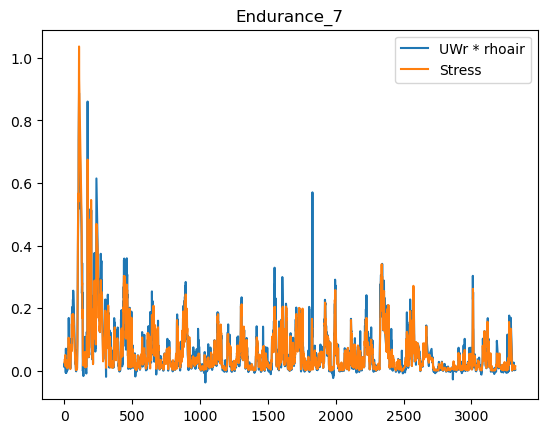

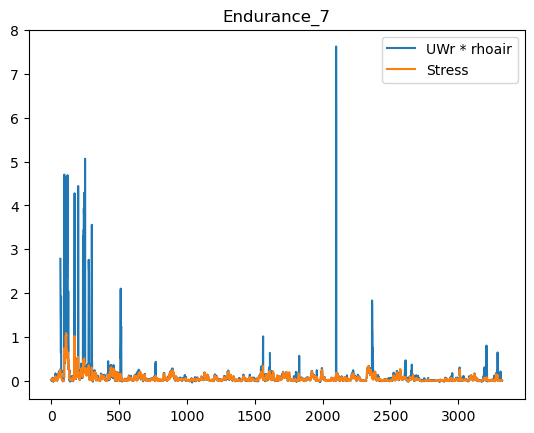

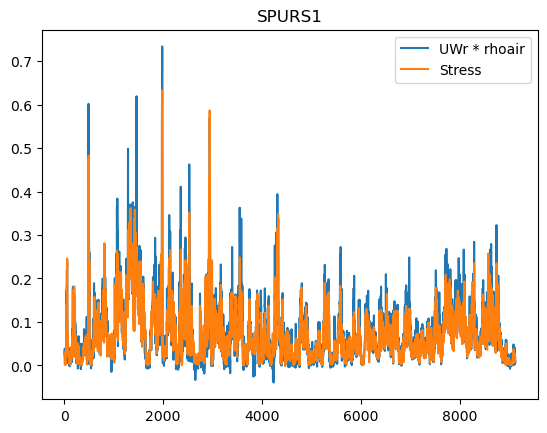

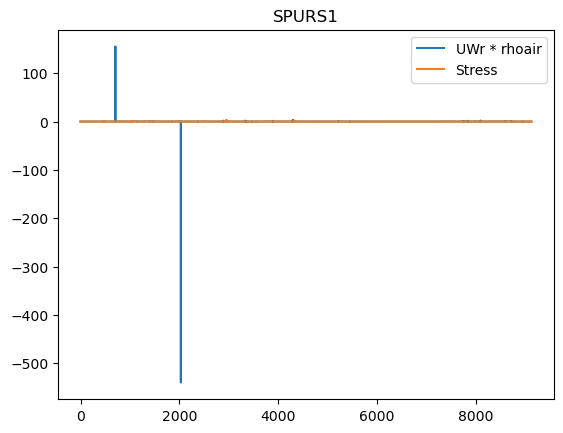

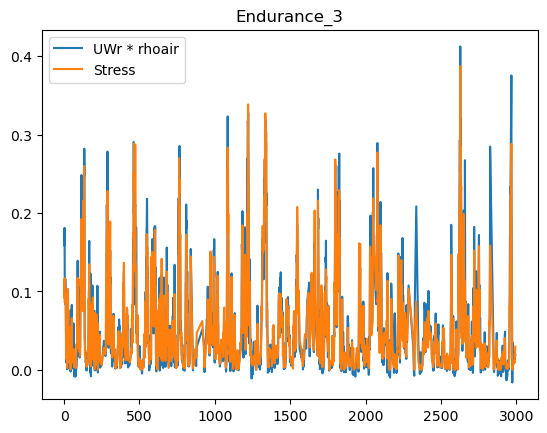

...

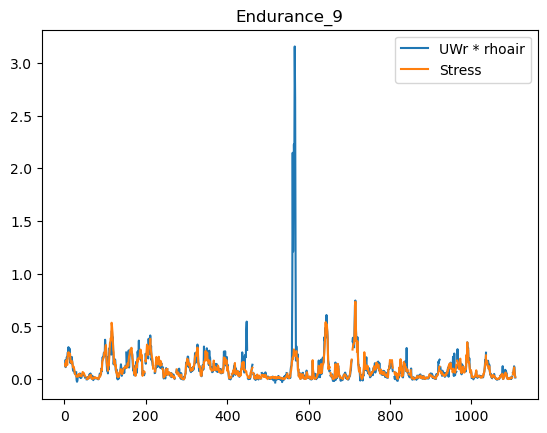

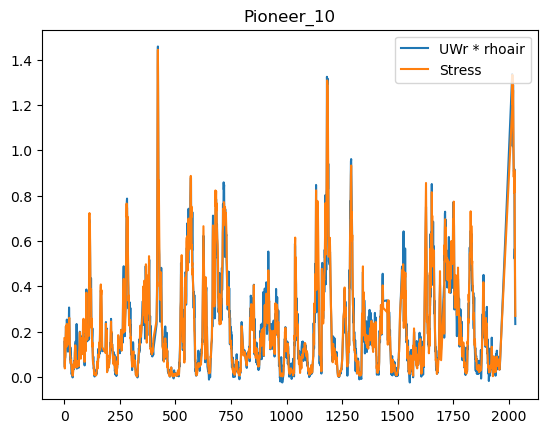

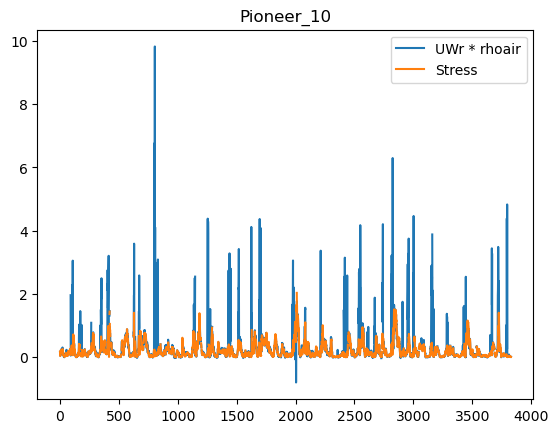

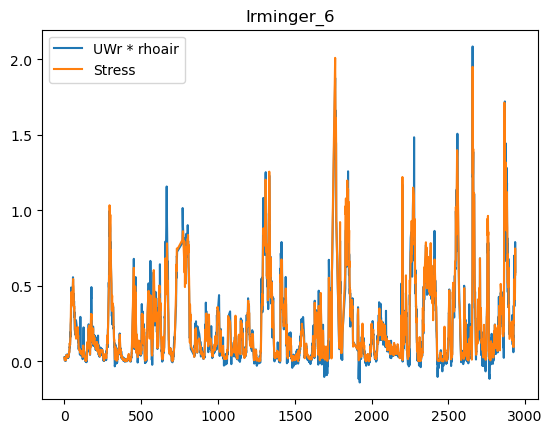

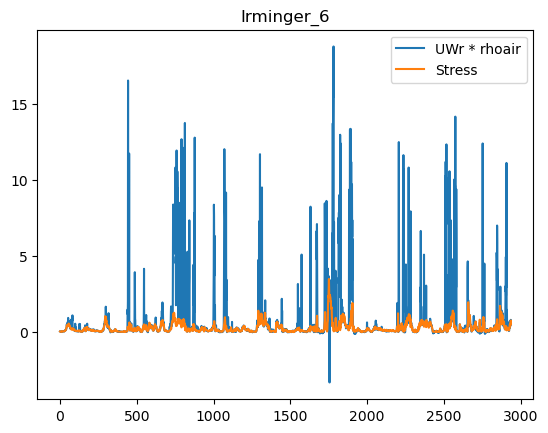

In [9]:
# for each of the datasets, do some data cleanup
# if quality flag entries for which:
# - SBytes != 0
# - any column is inf
# - any column is larger than 1e8
# - any column is close to 9999
# - UW is smaller than some given bounds
# - UW is larger than some given bounds

for crrt_dataset in dict_all_Transfer_files:
    #ic(crrt_dataset)
    time.sleep(0.5)

    crrt_pd = dict_all_Transfer_files[crrt_dataset]

    # valid rows by default
    validity_flag = np.ones((len(crrt_pd.index),), dtype=bool)

    # if find any reason why the row looks bad, invalid it
    for index, row in tqdm.tqdm(crrt_pd.iterrows(), total=len(crrt_pd.index)):

        # NOTE: here are the validity conditions; is it ok to remove the far tails?
        if \
            row["Sbytes"] != 0 or \
            (not np.all(np.isfinite((row[predictors].to_numpy().astype(np.float32))))) or \
            (np.any(row[predictors].to_numpy().astype(np.float32) > 1.0e8)) or \
            (np.any(np.abs(np.real(row[predictors].to_numpy()).astype(np.float32) - 9999.) < 1)) or \
            (row['UW'] < -2.0) or \
            (row['UW'] > 0.2) or \
            (row['UWr'] < -2.0) or \
            (row['UWr'] > 0.2):

            validity_flag[index] = 0

    # add information
    crrt_pd["valid_flag"] = validity_flag
    crrt_pd_valid = crrt_pd.loc[crrt_pd['valid_flag'] == True]
    
    path_strings = str(crrt_dataset).split('.')[0].split('_')
    if path_strings[-1].isnumeric(): 
        buoy = path_strings[-2] + '_' + path_strings[-1]
    else:
        buoy = path_strings[-1]
    print(np.sum(validity_flag), validity_flag.shape)
    plt.figure()
    plt.plot(- crrt_pd_valid['UWr'] * crrt_pd_valid['rhoair'], label='UWr * rhoair')
    plt.plot(crrt_pd_valid['stress'], label='Stress')
    plt.legend()
    plt.title(buoy)
    
    plt.figure()
    plt.plot(- crrt_pd['UWr'] * crrt_pd['rhoair'], label='UWr * rhoair')
    plt.plot(crrt_pd['stress'], label='Stress')
    plt.legend()
    plt.title(buoy)

In [10]:
crrt_dataset

PosixPath('/lustre/storeB/project/IT/geout/machine-ocean/prepared_datasets/in_situ_data_WHOI/WHOI/Transfer_Irminger_6.mat')

In [11]:
crrt_pd

,CE,CN,IR,Lv,P10,Pair,Q10,Qair,RH,RH10,...,sigHDir,stress,ustar,yday,yyyy,datetime,lat,lon,datetime_rounded,valid_flag
0,0.058741,0.083610,339.925002,2474.768030,1017.944242,1019.167502,7.248714,7.267303,93.933302,94.014437,...,106.608233,0.023803,0.138781,223.007639,2019,2019-08-11 00:10:59.996491,59.9337,-39.47378,2019-08-11 00:00:00,True
1,0.110629,0.096598,297.949997,2475.081231,1017.797864,1019.020508,7.268667,7.284779,93.525552,93.591409,...,101.552518,0.017449,0.118826,223.049306,2019,2019-08-11 01:10:59.999656,59.9337,-39.47378,2019-08-11 01:00:00,True
2,0.139019,0.126999,348.530000,2475.050118,1017.764995,1018.986008,7.469067,7.480979,93.906953,93.964349,...,98.317455,0.010006,0.089936,223.090972,2019,2019-08-11 02:11:00.000769,59.9337,-39.47378,2019-08-11 02:00:00,True
3,0.187421,0.070342,337.279997,2475.037386,1017.700083,1018.920502,7.588145,7.597242,94.722052,94.793354,...,101.308285,0.006871,0.074493,223.132639,2019,2019-08-11 03:10:59.998945,59.9337,-39.47378,2019-08-11 03:00:00,True
4,0.140239,0.010441,327.305002,2475.172549,1017.320471,1018.540506,7.613828,7.622443,95.132553,95.198827,...,106.933136,0.007151,0.075996,223.174306,2019,2019-08-11 04:10:59.997584,59.9337,-39.47378,2019-08-11 04:00:00,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2932,0.078067,-0.018678,273.325001,2491.943886,997.514969,998.760501,3.100641,3.165751,80.403552,79.658724,...,204.795173,0.419266,0.576409,387.215972,2020,2020-01-22 05:10:59.952046,59.9337,-39.47378,2020-01-22 05:00:00,True
2933,0.078067,-0.018678,269.544999,2491.941121,997.503489,998.747000,2.916729,2.990077,73.412752,72.353448,...,206.919255,0.409373,0.569918,387.257639,2020,2020-01-22 06:10:59.975539,59.9337,-39.47378,2020-01-22 06:00:00,True
2934,0.078067,-0.018678,282.610001,2491.938347,997.989629,999.240002,3.011154,3.093219,83.999203,82.909322,...,196.948117,0.498005,0.627132,387.299306,2020,2020-01-22 07:11:00.006928,59.9337,-39.47378,2020-01-22 07:00:00,True
2935,0.078067,-0.018678,258.055002,2491.916288,998.007711,999.254504,2.977888,3.049324,78.179452,77.277268,...,209.921894,0.748459,0.769358,387.340972,2020,2020-01-22 08:10:59.967979,59.9337,-39.47378,2020-01-22 08:00:00,True


# Get buoy name from the dict keys

In [12]:
d = dict_all_Transfer_files

In [13]:
buoys = []
for key in d.keys():
    path_strings = str(key).split('.')[0].split('_')
    if path_strings[-1].isnumeric(): 
        buoy = path_strings[-2] + '_' + path_strings[-1]
    else:
        buoy = path_strings[-1]
    buoys.append(buoy)
buoys

['Endurance_7',
 'SPURS1',
 'Endurance_3',
 'Pioneer_6',
 'Endurance_8',
 'Pioneer_8',
 'Irminger_3',
 'SPURS2',
 'SouthernOcean2',
 'Pioneer_5',
 'Pioneer_3',
 'Pioneer_7',
 'Endurance_4',
 'CLIMODE',
 'Irminger_7',
 'Endurance_9',
 'Pioneer_10',
 'Irminger_6']

In [14]:
d[key].keys()

Index(['CE', 'CN', 'IR', 'Lv', 'P10', 'Pair', 'Q10', 'Qair', 'RH', 'RH10',
       'SSQ', 'SST', 'Sbytes', 'Solar', 'T10', 'Tair', 'Tm', 'Tp', 'Tsea',
       'Tseasonic', 'Tsonic', 'U10e', 'U10r', 'UE', 'UEr', 'UN', 'UNr', 'UW',
       'UWr', 'Ue', 'Ur', 'VW', 'VWr', 'WT', 'WTr', 'Wdir', 'Wdirr', 'cp',
       'lhf', 'moL', 'mtime', 'rain', 'rhoair', 'shf', 'sigH', 'sigHDir',
       'stress', 'ustar', 'yday', 'yyyy', 'datetime', 'lat', 'lon',
       'datetime_rounded', 'valid_flag'],
      dtype='object')

In [15]:
key

PosixPath('/lustre/storeB/project/IT/geout/machine-ocean/prepared_datasets/in_situ_data_WHOI/WHOI/Transfer_Irminger_6.mat')

In [16]:
df_in_situ = d[key]
df_in_situ

,CE,CN,IR,Lv,P10,Pair,Q10,Qair,RH,RH10,...,sigHDir,stress,ustar,yday,yyyy,datetime,lat,lon,datetime_rounded,valid_flag
0,0.058741,0.083610,339.925002,2474.768030,1017.944242,1019.167502,7.248714,7.267303,93.933302,94.014437,...,106.608233,0.023803,0.138781,223.007639,2019,2019-08-11 00:10:59.996491,59.9337,-39.47378,2019-08-11 00:00:00,True
1,0.110629,0.096598,297.949997,2475.081231,1017.797864,1019.020508,7.268667,7.284779,93.525552,93.591409,...,101.552518,0.017449,0.118826,223.049306,2019,2019-08-11 01:10:59.999656,59.9337,-39.47378,2019-08-11 01:00:00,True
2,0.139019,0.126999,348.530000,2475.050118,1017.764995,1018.986008,7.469067,7.480979,93.906953,93.964349,...,98.317455,0.010006,0.089936,223.090972,2019,2019-08-11 02:11:00.000769,59.9337,-39.47378,2019-08-11 02:00:00,True
3,0.187421,0.070342,337.279997,2475.037386,1017.700083,1018.920502,7.588145,7.597242,94.722052,94.793354,...,101.308285,0.006871,0.074493,223.132639,2019,2019-08-11 03:10:59.998945,59.9337,-39.47378,2019-08-11 03:00:00,True
4,0.140239,0.010441,327.305002,2475.172549,1017.320471,1018.540506,7.613828,7.622443,95.132553,95.198827,...,106.933136,0.007151,0.075996,223.174306,2019,2019-08-11 04:10:59.997584,59.9337,-39.47378,2019-08-11 04:00:00,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2932,0.078067,-0.018678,273.325001,2491.943886,997.514969,998.760501,3.100641,3.165751,80.403552,79.658724,...,204.795173,0.419266,0.576409,387.215972,2020,2020-01-22 05:10:59.952046,59.9337,-39.47378,2020-01-22 05:00:00,True
2933,0.078067,-0.018678,269.544999,2491.941121,997.503489,998.747000,2.916729,2.990077,73.412752,72.353448,...,206.919255,0.409373,0.569918,387.257639,2020,2020-01-22 06:10:59.975539,59.9337,-39.47378,2020-01-22 06:00:00,True
2934,0.078067,-0.018678,282.610001,2491.938347,997.989629,999.240002,3.011154,3.093219,83.999203,82.909322,...,196.948117,0.498005,0.627132,387.299306,2020,2020-01-22 07:11:00.006928,59.9337,-39.47378,2020-01-22 07:00:00,True
2935,0.078067,-0.018678,258.055002,2491.916288,998.007711,999.254504,2.977888,3.049324,78.179452,77.277268,...,209.921894,0.748459,0.769358,387.340972,2020,2020-01-22 08:10:59.967979,59.9337,-39.47378,2020-01-22 08:00:00,True


In [17]:
df_in_situ['datetime'] = pd.to_datetime(df_in_situ['datetime'])
df_in_situ = df_in_situ.set_index('datetime')
df_in_situ

,CE,CN,IR,Lv,P10,Pair,Q10,Qair,RH,RH10,...,sigH,sigHDir,stress,ustar,yday,yyyy,lat,lon,datetime_rounded,valid_flag
datetime,,,,,,,,,,,,,,,,,,,,,
2019-08-11 00:10:59.996491,0.058741,0.083610,339.925002,2474.768030,1017.944242,1019.167502,7.248714,7.267303,93.933302,94.014437,...,1.21,106.608233,0.023803,0.138781,223.007639,2019,59.9337,-39.47378,2019-08-11 00:00:00,True
2019-08-11 01:10:59.999656,0.110629,0.096598,297.949997,2475.081231,1017.797864,1019.020508,7.268667,7.284779,93.525552,93.591409,...,1.06,101.552518,0.017449,0.118826,223.049306,2019,59.9337,-39.47378,2019-08-11 01:00:00,True
2019-08-11 02:11:00.000769,0.139019,0.126999,348.530000,2475.050118,1017.764995,1018.986008,7.469067,7.480979,93.906953,93.964349,...,1.12,98.317455,0.010006,0.089936,223.090972,2019,59.9337,-39.47378,2019-08-11 02:00:00,True
2019-08-11 03:10:59.998945,0.187421,0.070342,337.279997,2475.037386,1017.700083,1018.920502,7.588145,7.597242,94.722052,94.793354,...,1.20,101.308285,0.006871,0.074493,223.132639,2019,59.9337,-39.47378,2019-08-11 03:00:00,True
2019-08-11 04:10:59.997584,0.140239,0.010441,327.305002,2475.172549,1017.320471,1018.540506,7.613828,7.622443,95.132553,95.198827,...,1.02,106.933136,0.007151,0.075996,223.174306,2019,59.9337,-39.47378,2019-08-11 04:00:00,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-01-22 05:10:59.952046,0.078067,-0.018678,273.325001,2491.943886,997.514969,998.760501,3.100641,3.165751,80.403552,79.658724,...,4.88,204.795173,0.419266,0.576409,387.215972,2020,59.9337,-39.47378,2020-01-22 05:00:00,True
2020-01-22 06:10:59.975539,0.078067,-0.018678,269.544999,2491.941121,997.503489,998.747000,2.916729,2.990077,73.412752,72.353448,...,5.03,206.919255,0.409373,0.569918,387.257639,2020,59.9337,-39.47378,2020-01-22 06:00:00,True
2020-01-22 07:11:00.006928,0.078067,-0.018678,282.610001,2491.938347,997.989629,999.240002,3.011154,3.093219,83.999203,82.909322,...,4.80,196.948117,0.498005,0.627132,387.299306,2020,59.9337,-39.47378,2020-01-22 07:00:00,True


# Import ASCAT data and params

In [18]:
data_dir = "/lustre/storeB/project/IT/geout/machine-ocean/data_raw/sentinel/"

In [19]:
with open(data_dir + 'in_situ_obs_with_sar_params.pickle', 'rb') as handle:
        sar_dict = pickle.load(handle)

In [20]:
sar_dict['Endurance_8'].keys()

dict_keys(['datetime_start', 'datetime_end', 'type', 'lat', 'lon', 'nc_data_location', 'products'])

In [21]:
sar_dict

{'Endurance_8': {'datetime_start': datetime.datetime(2018, 9, 23, 5, 9, 59, 972136, tzinfo=<UTC>),
  'datetime_end': datetime.datetime(2018, 12, 2, 4, 10, 0, 31061, tzinfo=<UTC>),
  'type': 'whoi_buoy',
  'lat': [44.6393],
  'lon': [-124.304],
  'nc_data_location': 'received, exported from .mat',
  'products': OrderedDict([('838f54c9-6255-4a1d-9bf7-d6dda743fd38',
                {'title': 'S1A_IW_GRDH_1SDV_20181126T142233_20181126T142258_024760_02B976_067A',
                 'link': "https://scihub.copernicus.eu/dhus/odata/v1/Products('838f54c9-6255-4a1d-9bf7-d6dda743fd38')/$value",
                 'link_alternative': "https://scihub.copernicus.eu/dhus/odata/v1/Products('838f54c9-6255-4a1d-9bf7-d6dda743fd38')/",
                 'link_icon': "https://scihub.copernicus.eu/dhus/odata/v1/Products('838f54c9-6255-4a1d-9bf7-d6dda743fd38')/Products('Quicklook')/$value",
                 'summary': 'Date: 2018-11-26T14:22:33.047Z, Instrument: SAR-C SAR, Mode: VV VH, Satellite: Sentinel-1, Siz

# Import normalized SAR data and params

In [18]:
data_dir = "/lustre/storeB/project/IT/geout/machine-ocean/data_raw/sentinel/"

In [19]:
with open(data_dir + 'in_situ_obs_with_sar_params.pickle', 'rb') as handle:
        sar_dict = pickle.load(handle)

In [20]:
sar_dict['Endurance_8'].keys()

dict_keys(['datetime_start', 'datetime_end', 'type', 'lat', 'lon', 'nc_data_location', 'products'])

In [21]:
sar_dict

{'Endurance_8': {'datetime_start': datetime.datetime(2018, 9, 23, 5, 9, 59, 972136, tzinfo=<UTC>),
  'datetime_end': datetime.datetime(2018, 12, 2, 4, 10, 0, 31061, tzinfo=<UTC>),
  'type': 'whoi_buoy',
  'lat': [44.6393],
  'lon': [-124.304],
  'nc_data_location': 'received, exported from .mat',
  'products': OrderedDict([('838f54c9-6255-4a1d-9bf7-d6dda743fd38',
                {'title': 'S1A_IW_GRDH_1SDV_20181126T142233_20181126T142258_024760_02B976_067A',
                 'link': "https://scihub.copernicus.eu/dhus/odata/v1/Products('838f54c9-6255-4a1d-9bf7-d6dda743fd38')/$value",
                 'link_alternative': "https://scihub.copernicus.eu/dhus/odata/v1/Products('838f54c9-6255-4a1d-9bf7-d6dda743fd38')/",
                 'link_icon': "https://scihub.copernicus.eu/dhus/odata/v1/Products('838f54c9-6255-4a1d-9bf7-d6dda743fd38')/Products('Quicklook')/$value",
                 'summary': 'Date: 2018-11-26T14:22:33.047Z, Instrument: SAR-C SAR, Mode: VV VH, Satellite: Sentinel-1, Siz

# Merge in situ obs and SAR data

empty dict for new dfs

For each key in d:

    get buoy name
    get df for that buoy
    add empty cols for s0, inc, az
    for each product
        find closest timestamp in df to (beginposition+(endposition-startposition))/2
        fill in that row with sar params
    remove rows with nans
    save df with matches in new dict


In [21]:
dt = datetime.datetime(2019, 8, 11, 0, 10, 49, 874000)
#dt + dt

In [22]:
idx = df_in_situ.index.get_indexer([dt], method='nearest')[0]
idx

0

In [23]:
timestamp = df_in_situ.index[idx]
timestamp

Timestamp('2019-08-11 00:10:59.996491')

In [24]:
buoys

['Endurance_7',
 'SPURS1',
 'Endurance_3',
 'Pioneer_6',
 'Endurance_8',
 'Pioneer_8',
 'Irminger_3',
 'SPURS2',
 'SouthernOcean2',
 'Pioneer_5',
 'Pioneer_3',
 'Pioneer_7',
 'Endurance_4',
 'CLIMODE',
 'Irminger_7',
 'Endurance_9',
 'Pioneer_10',
 'Irminger_6']

epsilon = 5e-05
count = 0
collocated_dict = {}
for key, df in d.items():
    buoy = buoys[count]
    df['s0_norm'] = np.nan
    df['s0'] = np.nan
    df['inc'] = np.nan
    df['az'] = np.nan
    df_in_situ = d[key]
    df_in_situ['datetime'] = pd.to_datetime(df_in_situ['datetime'])
    df_in_situ = df_in_situ.set_index('datetime')
    
    for product in sar_dict[buoy]['products']:
        beginposition = sar_dict[buoy]['products'][product]['beginposition']
        endposition = sar_dict[buoy]['products'][product]['endposition']
        #sar_time = (beginposition + (endposition - startposition))/2  # 
        #TypeError: unsupported operand type(s) for +: 'datetime.datetime' and 'datetime.datetime'
        
        try:
            s0 = sar_dict[buoy]['products'][product]['sar_params'][str(epsilon)]['s0']
            s0_norm = sar_dict[buoy]['products'][product]['sar_params'][str(epsilon)]['s0_norm']
            inc = sar_dict[buoy]['products'][product]['sar_params'][str(epsilon)]['inc']
            az = sar_dict[buoy]['products'][product]['sar_params'][str(epsilon)]['az']

            # Find closest timestamp
            idx = df_in_situ.index.get_indexer([beginposition], method='nearest')[0]
            timestamp = df_in_situ.index[idx]

            # Fill in data
            df_in_situ.loc[df_in_situ.index==timestamp, 's0'] = s0
            df_in_situ.loc[df_in_situ.index==timestamp, 's0_norm'] = s0_norm
            df_in_situ.loc[df_in_situ.index==timestamp, 'inc'] = inc
            df_in_situ.loc[df_in_situ.index==timestamp, 'az'] = az
            print(buoy, s0)
        except:
            df_in_situ = pd.DataFrame()
            df_in_situ['s0'] = np.nan
            #print('File ', sar_dict[buoy]['products'][product]['filename'], ' does not exist')
    df_in_situ = df_in_situ.dropna(subset=['s0'])
    collocated_dict[buoy] = df_in_situ
    print(count)             
    count = count + 1

In [25]:
epsilon = 5e-05
count = 0
collocated_dict = {}
for key, df in d.items():
    buoy = buoys[count]
    df['s0_norm'] = np.nan
    df['s0'] = np.nan
    df['inc'] = np.nan
    df['az'] = np.nan
    df_in_situ = d[key]
    df_in_situ = df_in_situ.loc[df_in_situ['valid_flag'] == True]
    df_in_situ['datetime'] = pd.to_datetime(df_in_situ['datetime'])
    df_in_situ = df_in_situ.set_index('datetime')
    
    for product in sar_dict[buoy]['products']:
        beginposition = sar_dict[buoy]['products'][product]['beginposition']
        endposition = sar_dict[buoy]['products'][product]['endposition']
        #sar_time = (beginposition + (endposition - startposition))/2  # 
        #TypeError: unsupported operand type(s) for +: 'datetime.datetime' and 'datetime.datetime'
        if str(epsilon) in sar_dict[buoy]['products'][product]['sar_params'] :
            s0 = sar_dict[buoy]['products'][product]['sar_params'][str(epsilon)]['s0']
            s0_norm = sar_dict[buoy]['products'][product]['sar_params'][str(epsilon)]['s0_norm']
            inc = sar_dict[buoy]['products'][product]['sar_params'][str(epsilon)]['inc']
            az = sar_dict[buoy]['products'][product]['sar_params'][str(epsilon)]['az']

            # Find closest timestamp
            idx = df_in_situ.index.get_indexer([beginposition], method='nearest')[0]
            timestamp = df_in_situ.index[idx]

            # Fill in data
            df_in_situ.loc[df_in_situ.index==timestamp, 's0'] = np.nanmean(s0)
            df_in_situ.loc[df_in_situ.index==timestamp, 's0_max'] = np.nanmax(s0)
            df_in_situ.loc[df_in_situ.index==timestamp, 's0_min'] = np.nanmin(s0)
            df_in_situ.loc[df_in_situ.index==timestamp, 's0_std'] = np.nanstd(s0)
            df_in_situ.loc[df_in_situ.index==timestamp, 's0_norm'] = np.nanmean(s0_norm)
            df_in_situ.loc[df_in_situ.index==timestamp, 'inc'] = np.nanmean(inc)
            df_in_situ.loc[df_in_situ.index==timestamp, 'az'] = np.nanmean(az)
            print(buoy, np.nanmean(s0))
            if np.nanmean(s0)==-np.inf:
                print(sar_dict[buoy]['products'][product]['filename'])
                print(np.nanmean(s0))
                print(s0)
        #else:
        #    df_in_situ = pd.DataFrame()
        #    df_in_situ['s0'] = np.nan
            #print('File ', sar_dict[buoy]['products'][product]['filename'], ' does not exist')
    
    df_in_situ = df_in_situ.replace([-np.inf], np.nan)
    df_in_situ = df_in_situ.dropna(subset=['s0'])
    collocated_dict[buoy] = df_in_situ
    print(count)             
    count = count + 1

/tmp/ipykernel_533589/1354920313.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_in_situ['datetime'] = pd.to_datetime(df_in_situ['datetime'])
/tmp/ipykernel_533589/1354920313.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_in_situ['datetime'] = pd.to_datetime(df_in_situ['datetime'])
/tmp/ipykernel_533589/1354920313.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the 

Endurance_7 -25.417974
Endurance_7 -19.978455
Endurance_7 -22.376661
Endurance_7 -21.916704
Endurance_7 -24.083054
Endurance_7 -22.989702
Endurance_7 -22.085495
Endurance_7 -32.322758
Endurance_7 -17.546288
Endurance_7 -18.29441
Endurance_7 -22.375942
Endurance_7 -23.172626
Endurance_7 -20.115118
Endurance_7 -19.828527
Endurance_7 -13.759415
Endurance_7 -21.803795
Endurance_7 -21.119408
Endurance_7 -17.72559
Endurance_7 -23.20425
Endurance_7 -15.81287
Endurance_7 -19.121897
Endurance_7 -18.735525
Endurance_7 -20.925276
Endurance_7 -22.98156
Endurance_7 -18.343288
Endurance_7 -13.824358
Endurance_7 -15.691008
Endurance_7 -8.815776
0
1
Endurance_3 -25.884995
Endurance_3 -23.426035
Endurance_3 -23.649767
Endurance_3 -17.834297
Endurance_3 -24.875008
Endurance_3 -17.510237
Endurance_3 -23.881264
Endurance_3 -19.831776
Endurance_3 -23.88126
Endurance_3 -19.973515
2
Pioneer_6 -10.382702
Pioneer_6 -27.263283
Pioneer_6 -19.65894
Pioneer_6 -18.949396
Pioneer_6 -17.16009
Pioneer_6 -10.573248
Pio

/tmp/ipykernel_533589/1354920313.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_in_situ['datetime'] = pd.to_datetime(df_in_situ['datetime'])
/tmp/ipykernel_533589/1354920313.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_in_situ['datetime'] = pd.to_datetime(df_in_situ['datetime'])


Irminger_3 -16.30730891958172
Irminger_3 -16.532013
Irminger_3 -22.702443072490578
Irminger_3 -18.68393762754344
Irminger_3 -11.893693798409613
Irminger_3 -12.582635587203892
Irminger_3 -12.221437718409419
Irminger_3 -16.940493741510217
Irminger_3 -17.97844364008729
Irminger_3 -18.68425791096798
Irminger_3 -23.37281632450013
Irminger_3 -19.353099996318402
Irminger_3 -18.108467831171374
Irminger_3 -21.510352370855543
Irminger_3 -18.65229477093799
Irminger_3 -23.22733797379373
6
7
8
Pioneer_5 -18.460157
Pioneer_5 -23.261824
Pioneer_5 -16.081299
Pioneer_5 -26.78363
Pioneer_5 -22.101871
9
Pioneer_3 -15.057678
Pioneer_3 -11.167887
Pioneer_3 -16.640633
Pioneer_3 -14.741343
Pioneer_3 -19.467966
Pioneer_3 -15.813181
Pioneer_3 -20.30817
Pioneer_3 -14.665132
Pioneer_3 -17.77367
Pioneer_3 -24.340767
10
Pioneer_7 -31.700638
Pioneer_7 -27.42479
Pioneer_7 -20.574146
Pioneer_7 -15.138701
Pioneer_7 -11.934892
Pioneer_7 -24.3408
Pioneer_7 -17.270258
Pioneer_7 -14.6644
Pioneer_7 -25.394909
Pioneer_7 -16

/tmp/ipykernel_533589/1354920313.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_in_situ['datetime'] = pd.to_datetime(df_in_situ['datetime'])
/tmp/ipykernel_533589/1354920313.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_in_situ['datetime'] = pd.to_datetime(df_in_situ['datetime'])
/tmp/ipykernel_533589/1354920313.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the 

13
Irminger_7 -24.38676704531954
Irminger_7 -22.020584823357904
Irminger_7 -20.662458429946604
Irminger_7 -16.660115576983443
Irminger_7 -23.502758673124635
Irminger_7 -15.796181675486885
Irminger_7 -17.7692965001984
Irminger_7 -18.654897246928957
Irminger_7 -10.136538797555954
Irminger_7 -19.180280961436697
Irminger_7 -12.846860415046716
Irminger_7 -24.387942931390313
Irminger_7 -14.246568418034895
Irminger_7 -14.947643116136756
Irminger_7 -17.91431159545113
Irminger_7 -12.041912261000595
Irminger_7 -10.41917230377853
Irminger_7 -19.01079797940554
Irminger_7 -20.267547008493445
Irminger_7 -14.161436797320713
Irminger_7 -15.160914208215539
Irminger_7 -20.26827201385491
Irminger_7 -19.386002644397422
Irminger_7 -16.183901581297814
Irminger_7 -9.47759081259651
Irminger_7 -19.527740742794023
Irminger_7 -21.633994051122226
Irminger_7 -15.054381505869237
Irminger_7 -11.879277928206214
Irminger_7 -10.470644692332016
Irminger_7 -6.404727395420919
Irminger_7 -23.503579451345992
Irminger_7 -16.

/tmp/ipykernel_533589/1354920313.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_in_situ['datetime'] = pd.to_datetime(df_in_situ['datetime'])
/tmp/ipykernel_533589/1354920313.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_in_situ['datetime'] = pd.to_datetime(df_in_situ['datetime'])
/tmp/ipykernel_533589/1354920313.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the 

In [26]:
collocated_dict['Pioneer_7'][['UWr', 'rhoair', 's0']].index.get_indexer([datetime.datetime(2017, 10, 22, 22, 42, 24, 875000)], method='nearest')

array([15])

In [27]:
collocated_dict['Pioneer_7'][['UWr', 'rhoair', 's0']]

,UWr,rhoair,s0
datetime,,,
2017-06-12 11:10:59.967536,-0.042344,1.212813,-17.345024
2017-06-12 23:10:59.983629,-0.036690,1.213003,-19.098715
2017-06-24 23:10:59.998837,-0.041088,1.192970,-22.158222
2017-07-06 11:10:59.995377,-0.019187,1.203083,-17.773577
2017-07-18 23:10:59.995096,-0.015328,1.179373,-23.181017
2017-07-30 11:11:00.010425,-0.094400,1.197105,-19.602615
2017-07-30 23:11:00.001312,-0.066846,1.201028,-16.332382
2017-08-12 00:11:00.042547,-0.001697,1.192977,-25.394909
2017-08-16 14:10:59.978429,-0.015690,1.183057,-14.664400


In [28]:
collocated_dict['Irminger_3'][['UWr', 'rhoair', 's0']]

,UWr,rhoair,s0
datetime,,,
2016-07-12 09:10:59.978919,-0.009191,1.253068,-23.227338
2016-07-17 09:10:59.980719,-0.054515,1.241977,-18.652295
2016-07-24 09:10:59.927229,-0.001812,1.242725,-21.510352
2016-07-29 09:10:59.986020,-0.023882,1.258025,-18.108468
2016-08-05 09:11:00.049035,-0.067082,1.241020,-19.353100
2016-08-10 09:11:00.047647,0.008055,1.228580,-23.372816
2016-08-17 09:10:59.986332,-0.019623,1.232933,-18.684258
2016-08-22 09:11:00.038786,-0.067431,1.251177,-17.978444
2016-08-29 09:11:00.012081,-0.066496,1.228615,-16.940494


with open(data_dir + 'collocated_dict_5e_5_filtered.pickle', 'wb') as handle:
    pickle.dump(collocated_dict, handle, protocol=pickle.HIGHEST_PROTOCOL)

In [35]:
sar_dict['Pioneer_7']['products']['7e1d1641-af53-4486-bb45-8411c61d1aba']['sar_params']['5e-05'].keys()

dict_keys(['epsilon', 's0', 's0_norm', 'inc', 'az', 'grid_lons', 'grid_lats', 'pol'])

In [36]:
collocated_dict['Irminger_7']['s0'].shape

(255,)